In [1]:
def InCircle(X, Y, X0, Y0, A):
    if (X - X0)**2 + (Y - Y0)**2 <= A**2:
        return True
    else:
        return False
    
def NewPoint(X, Y, X_Left, X_Right, Y_Left, Y_Right, i):
    if i == 0:
        return [(X + X_Left) / 2, (Y + Y_Right) / 2]
    if i == 1:
        return [X, (Y + Y_Right) / 2]
    if i == 2:
        return [(X + X_Right) / 2, (Y + Y_Right) / 2]
    if i == 3:
        return [(X + X_Right) / 2, Y]
    if i == 4:
        return [(X + X_Right) / 2, (Y + Y_Left) / 2]
    if i == 5:
        return [X, (Y + Y_Left) / 2]
    if i == 6:
        return [(X + X_Left) / 2, (Y + Y_Left) / 2]
    if i == 7:
        return [(X + X_Left) / 2, Y]
    
def RemoveDuplicates(Points):
    temp_set = set()
    temp_points = []
    
    for point in Points:
        t = tuple(point)
        if t not in temp_set:
            temp_points.append(point)
            temp_set.add(t)
            
    return temp_points

def DataSource(X, Y, X0, Y0, A):
    rez = []
    new_point = []
    
    for x_idx in range(0, np.size(X)):
        for y_idx in range(0, np.size(Y)):  
            if InCircle(X[x_idx], Y[y_idx], X0, Y0, A) and x_idx + 1 != np.size(X) and y_idx + 1 != np.size(Y):
                for i in range(8):
                    new_point = NewPoint(X[x_idx], Y[y_idx], X[x_idx-1], X[x_idx+1], Y[y_idx-1], Y[y_idx+1], i)
                    if InCircle(new_point[0], new_point[1], X0, Y0, A):
                        rez.append(new_point) 
            rez.append( [x[x_idx], Y[y_idx]] )
    rez = RemoveDuplicates(rez)
    
    return np.array(rez, dtype=float)

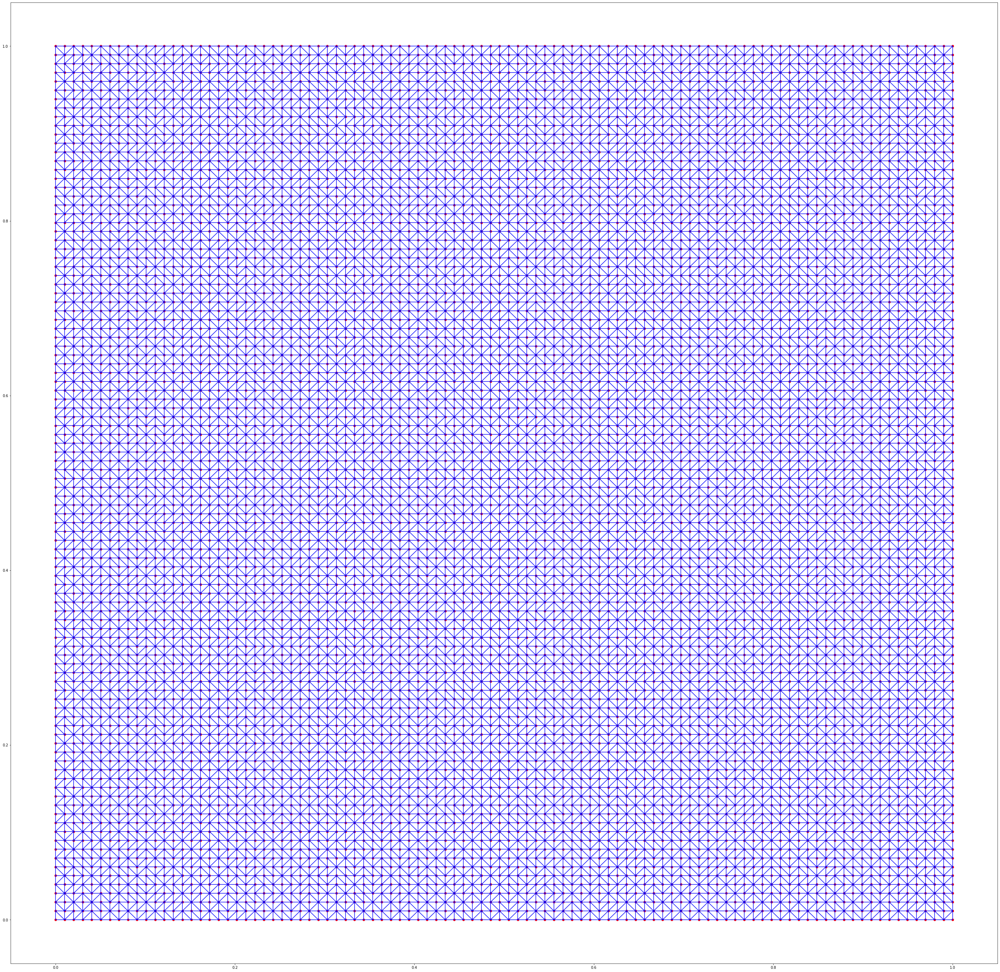

R =  0.0


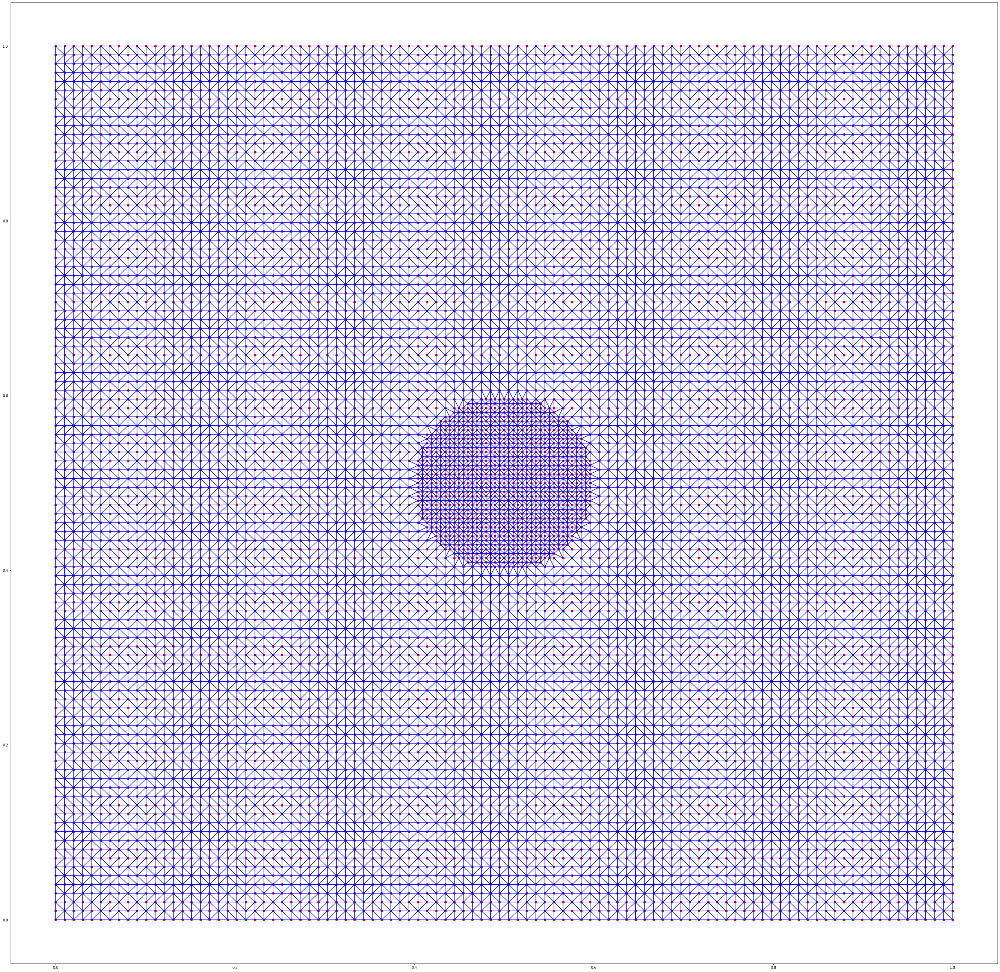

R =  0.1


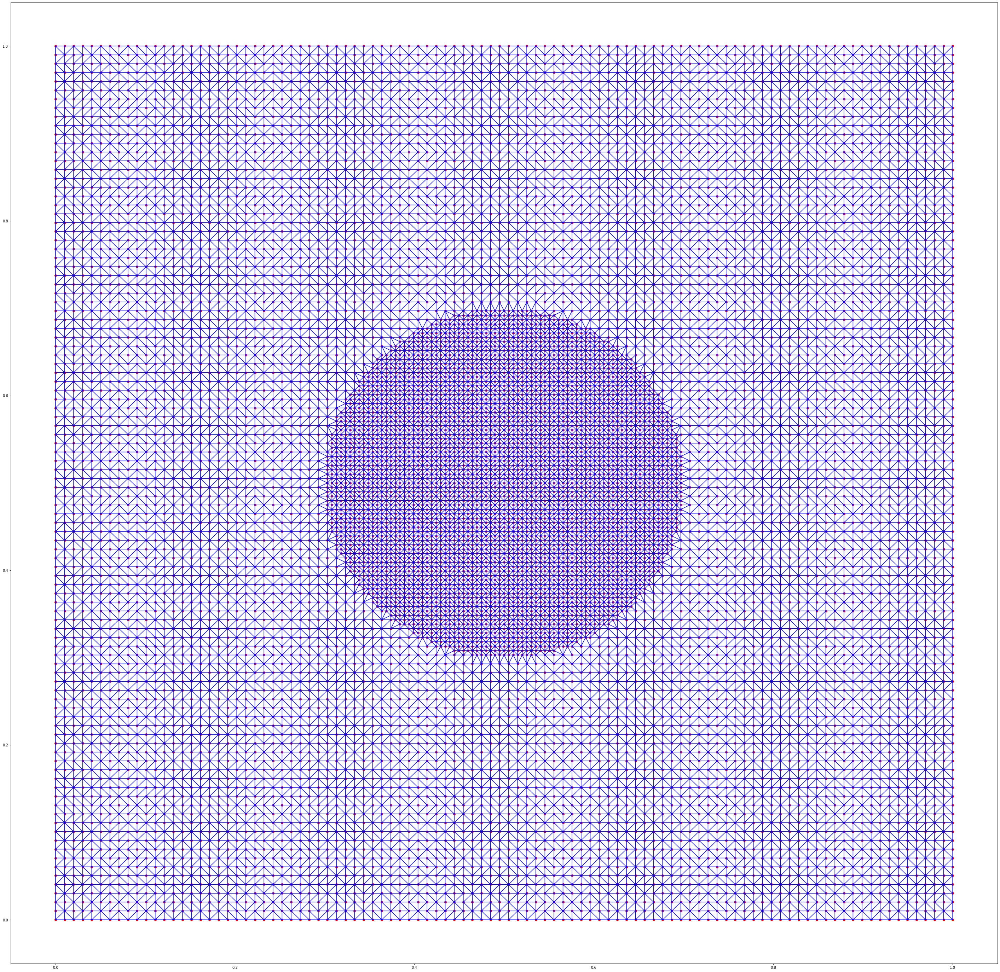

R =  0.2


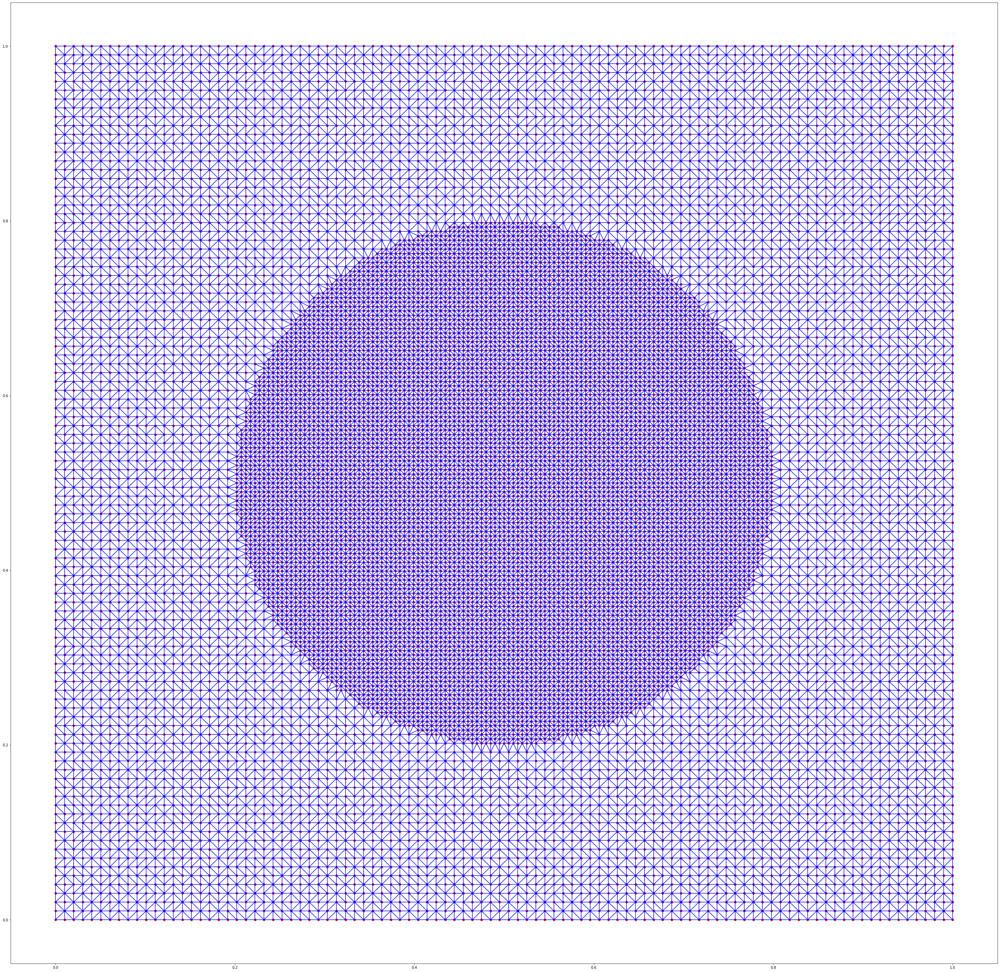

R =  0.3


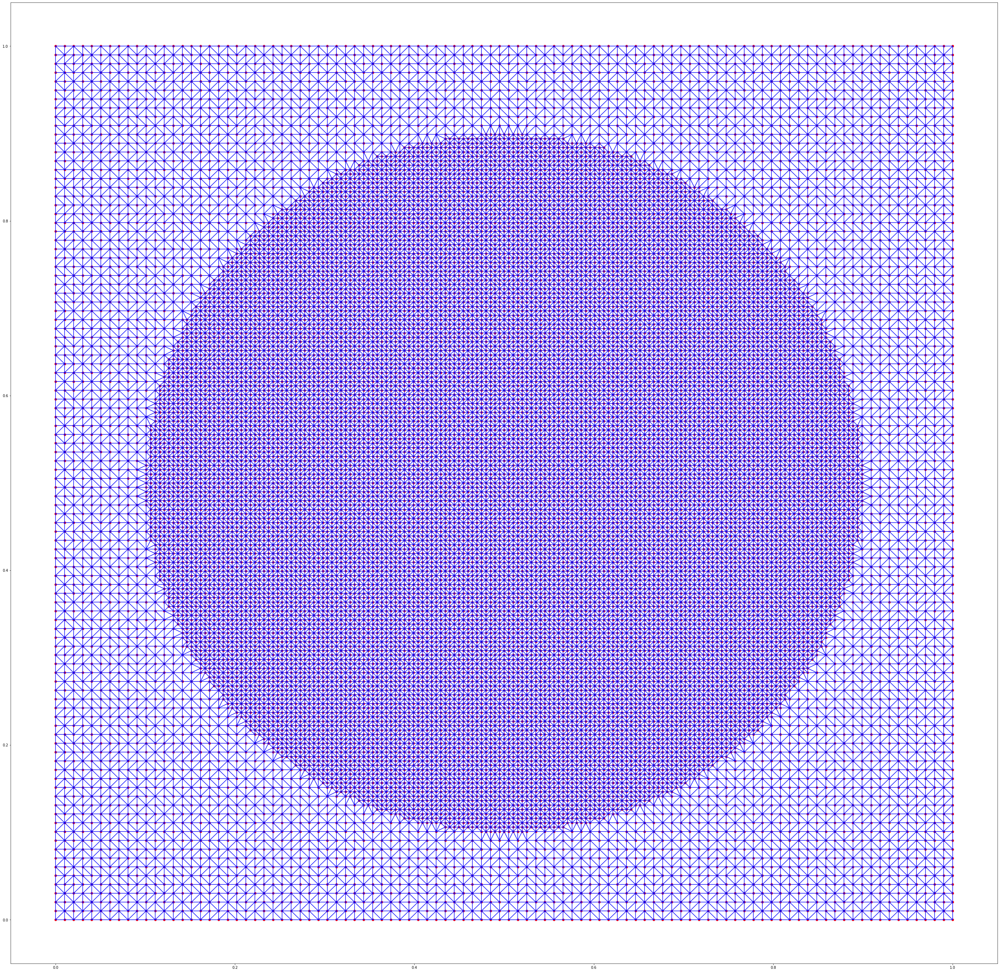

R =  0.4


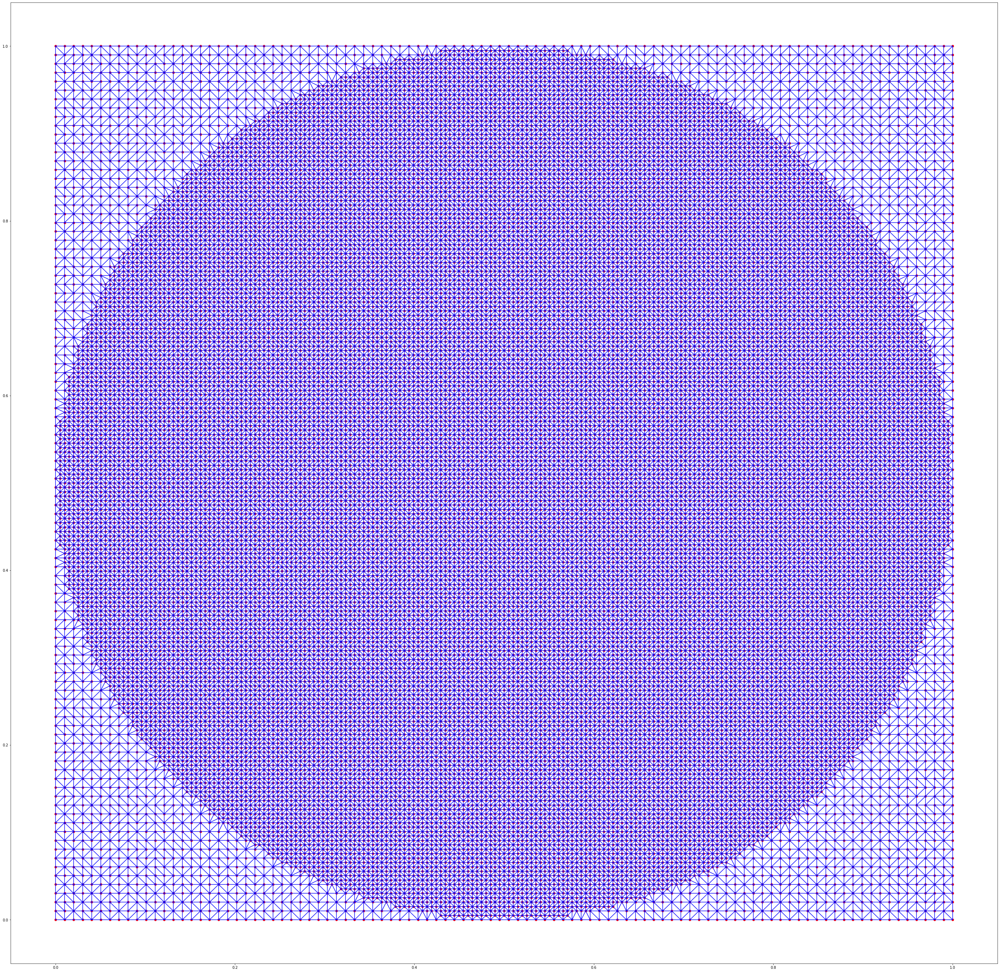

R =  0.5


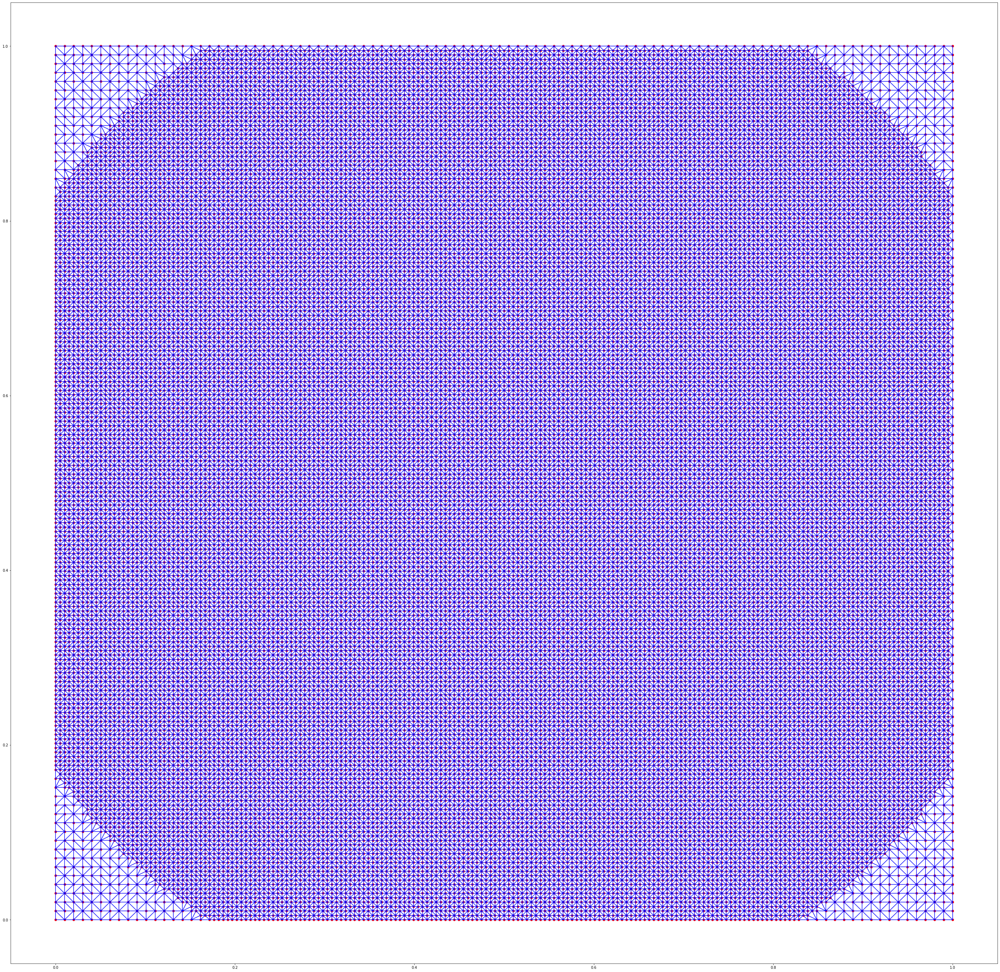

R =  0.6


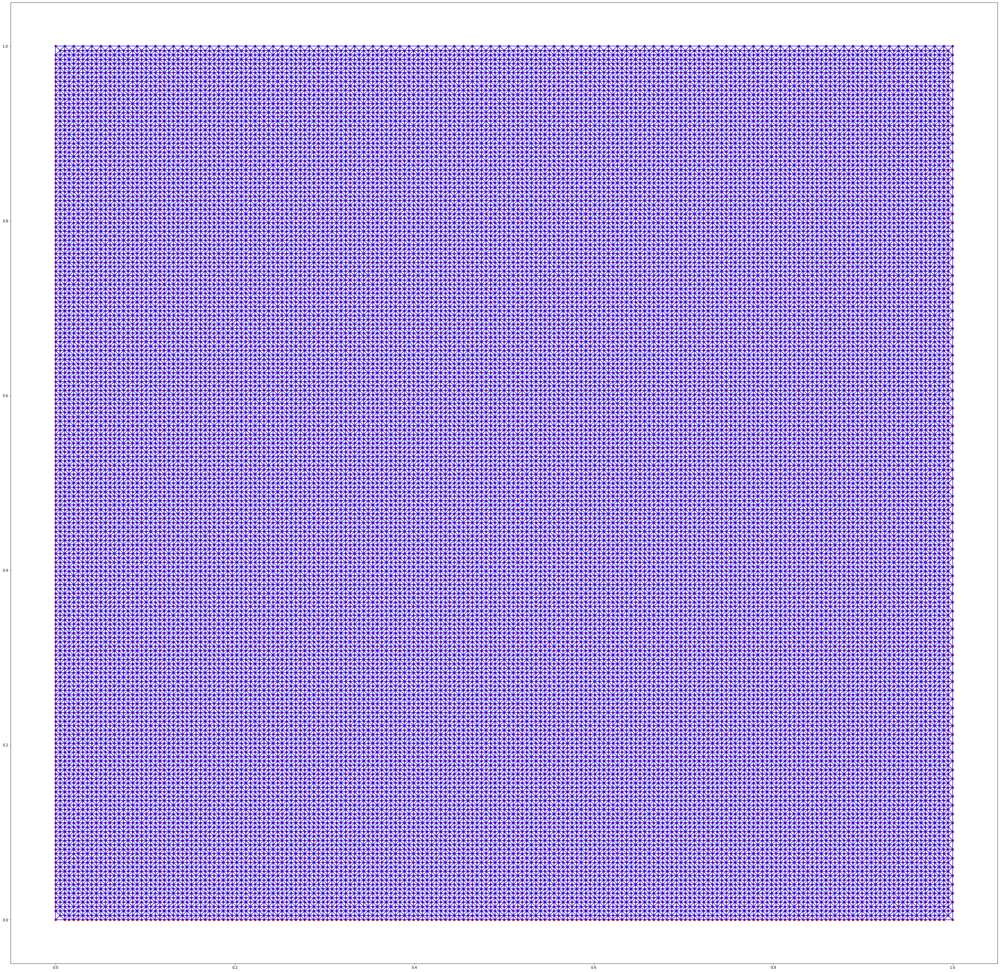

R =  0.7
Execution took: 0:00:31 secs


In [2]:
import numpy as np
from scipy.spatial import Delaunay
import matplotlib.pyplot as plt
import time
from datetime import timedelta
import math

start_time = time.time()

x = np.linspace(0, 1, 100)
y = np.linspace(0, 1, 100)

x0 = 0.5
y0 = 0.5
r = 0.
i = 0

size_fig = 50
file_name = str(size_fig) + '-' + str(size_fig)

while r < math.sqrt(2)/2:
    Data = DataSource(x, y, x0, y0, r)
    simplices = Delaunay(Data).simplices
    
    plt.figure(figsize=(size_fig, size_fig))
    plt.triplot(Data[:, 0], Data[:, 1], simplices, color='b')
    plt.scatter(Data[:, 0], Data[:, 1], color='r')
    
    plt.savefig('image_structed_mesh/' + file_name + '/test' + file_name + '_' + str(i) + '.png')
    i += 1
    
    plt.show()
    
    print('R = ',r)
    r += 0.1
    r = round(r,1)

elapsed_time_secs = time.time() - start_time
msg = "Execution took: %s secs" % timedelta(seconds=round(elapsed_time_secs))
print(msg)